<a href="https://colab.research.google.com/github/Indranil3001/Indranil3001/blob/Data-Driven-strategic-Decision-making/Netwoks_GH1026152.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

FB Pages Politicians

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np


##Loading Data##

In [ ]:
# Load edges
edges_df = pd.read_csv("/content/fb-pages-politician-edges.csv", header=None, names=["source", "target"])

# Load nodes
nodes_df = pd.read_csv("/content/fb-pages-politician-nodes.csv")

# Create a graph
G = nx.Graph()

# Add nodes
for _, row in nodes_df.iterrows():
    G.add_node(row["new_id"], name=row["name"], original_id=row["id"])

# Add edges
for _, row in edges_df.iterrows():
    G.add_edge(row["source"], row["target"])

# Print basic graph info
print(f"Number of nodes: {G.number_of_nodes()}")
print(f"Number of edges: {G.number_of_edges()}")
#print(f"Is the graph connected? {nx.is_connected(G)}")
#print(f"Average Degree: {nx.average_degree_connectivity(G)}")
#print(f"Diameter: {nx.diameter(G)}")
#print(f"Average Clustering Coefficient: {nx.average_clustering(G)}")
#print(f"Eigen Vector Centrality: {nx.eigenvector_centrality(G)}")
#print(f"Page Rank: {nx.pagerank(G)}")
#print(f"Closeness Centrality: {nx.closeness_centrality(G)}")
#print(f"Harmonic Centrality: {nx.harmonic_centrality(G)}")
#print(f"Betweenness Centrality: {nx.betweenness_centrality(G)}")
# Finding all the necessary parameters for the selected graph
# Clustering
#clustering = nx.clustering(G)
#df_clustering = pd.DataFrame.from_dict(clustering, orient='index', columns=['Clustering Coefficient'])
#print(df_clustering)
# Diameter
#diameter = nx.diameter(G)
#print(diameter)
# Degree
#degree = nx.degree(G)
#print(degree)

Number of nodes: 5908
Number of edges: 41729


**Functions for the Random network, Watts Strogatz and Barabasi Albert Graph**

In [ ]:
def create_random_network(num_nodes=5908, probablity=	0.00239013):
        G = nx.erdos_renyi_graph(num_nodes, probablity)
        return G

def watts_strogatz_network(num_nodes=5908, k=6, p=0.3):
        G = nx.watts_strogatz_graph(num_nodes, k, p)
        return G

def barabasi_albert_network(num_nodes=5908, m=4):
        G = nx.barabasi_albert_graph(num_nodes, m)
        return G

**Centrality measures functions**

In [ ]:


#def visualize_network (G):
        #plt.figure(figsize=(18, 16))
        #pos = nx.kamada_kawai_layout(G)
        #nx.draw(G, pos, with_labels=True, node_color ='orange', node_size=100, edge_color='grey', linewidths=1, font_size=5,alpha=0.5)
        #plt.title("Randomly Generated Network/Erdos Renyi Graph")
        #plt.show()




if __name__ == "__main__":
  num_nodes= 5908
  num_edges= 41729
  probablity= 0.00239013
  k=14    #Average degree
  m=7     #Number of edges to attach from a new node to existing nodes
  random_graph = create_random_network(num_nodes, probablity)
  Ws_g= watts_strogatz_network(num_nodes, k , probablity)
  Ba_g= barabasi_albert_network(num_nodes, m)
  #visualize_network(random_graph)


  #Plotting the degree distribution
def plot_degree_dist(G):
    degrees = [G.degree(n) for n in G.nodes()]
    plt.hist(degrees,bins=15,edgecolor='black')
    plt.xlabel('Degree')
    plt.ylabel('Frequency')
    plt.title('Degree Distribution')
    plt.show()

def clustering (G):
  #Clustering coefficient for the top 5 nodes
        clustering = nx.clustering(G)
        df_clustering = pd.DataFrame.from_dict(clustering, orient='index', columns=["Clustering Coefficient"])
        df_clustering = df_clustering.reset_index().rename(columns={"index": "Node"})
        df_clustering_5 = df_clustering.sort_values(by="Clustering Coefficient", ascending=False).head(5)
        avg_clustering = nx.average_clustering(G)
        density= nx.density(G)
        print(df_clustering_5)
        print(f"Average Density: {density}")
        print(f"Average Clustering Coefficient: {avg_clustering}")

def degree (G):
  #Degree of the top 5 nodes
        degree= nx.degree(G)
        degree_dict = dict(degree)
        df_degree = pd.DataFrame.from_dict(degree_dict, orient='index', columns=["Degree"])
        df_degree = df_degree.reset_index().rename(columns={"index": "Node"})
        df_degree_5 = df_degree.sort_values(by="Degree", ascending=False).head(5)

        print(df_degree_5)

#Diameter and the Path Length
def diameter_pathlen (G):

        if nx.is_connected(G):
          average_shortest_path = nx.average_shortest_path_length(G)
          diameter = nx.diameter(G)
          print(f"The diameter is: {diameter}")
          print(f"The average shortest path length is: {average_shortest_path}")
        else:

          print("The graph is not connected, so the diameter is undefined.")



def centrality (G):
  #Degree Centrality
        degree_centrality = nx.degree_centrality(G)
        df_degree_centrality = pd.DataFrame.from_dict(degree_centrality, orient='index', columns=["Degree Centrality"])
        df_degree_centrality = df_degree_centrality.reset_index().rename(columns={"index": "Node"})
        df_degree_centrality_5 = df_degree_centrality.sort_values(by="Degree Centrality", ascending=False).head(5)
        print("Top 5 most influential nodes based on Degree Centrality:")
        for index, row in df_degree_centrality_5.iterrows():
            print(f"Node: {row['Node']}, Degree Centrality: {row['Degree Centrality']}")


  #Eigenvector Centrality
        try:
          eigen = nx.eigenvector_centrality(G)  # Increase max_iter
        except nx.PowerIterationFailedConvergence:
            # print("Eigenvector Centrality failed to converge. "
            #       "The graph might be disconnected or have other problematic properties.")
            eigen = {}  # Assign an empty dictionary to handle non-converge
        df_eigen = pd.DataFrame.from_dict(eigen, orient='index', columns=["Eigenvector Centrality"])
        df_eigen = df_eigen.reset_index().rename(columns={"index": "Node"})
        df_eigen_5 = df_eigen.sort_values(by="Eigenvector Centrality", ascending=False).head(5)
        print("Top 5 most influential nodes based on Eigenvector Centrality:")
        for index, row in df_eigen_5.iterrows():
            print(f"Node: {row['Node']}, Eigenvector Centrality: {row['Eigenvector Centrality']}")


  #Page Rank
        pagerank = nx.pagerank(G, alpha=0.85)
        df_pagerank = pd.DataFrame.from_dict(pagerank, orient='index', columns=["Page Rank"])
        df_pagerank = df_pagerank.reset_index().rename(columns={"index": "Node"})
        df_pagerank_5 = df_pagerank.sort_values(by="Page Rank", ascending=False).head(5)
        print("Top 5 most influential nodes based on Page Rank:")
        for index, row in df_pagerank_5.iterrows():
            print(f"Node: {row['Node']}, Page Rank: {row['Page Rank']}")

  #Closeness Centrality
        closeness = nx.closeness_centrality(G)
        df_closeness = pd.DataFrame.from_dict(closeness, orient='index', columns=["Closeness Centrality"])
        df_closeness = df_closeness.reset_index().rename(columns={"index": "Node"})
        df_closeness_5= df_closeness.sort_values(by="Closeness Centrality", ascending=False).head(5)
        print("Top 5 most influential nodes based on Closeness Centrality:")
        for index, row in df_closeness_5.iterrows():
            print(f"Node: {row['Node']}, Closeness Centrality: {row['Closeness Centrality']}")

  #Harmonic Centrality
        harmonic = nx.harmonic_centrality(G)
        df_harmonic = pd.DataFrame.from_dict(harmonic, orient='index', columns=["Harmonic Centrality"])
        df_harmonic = df_harmonic.reset_index().rename(columns={"index": "Node"})

        df_harmonic_5 = df_harmonic.sort_values(by="Harmonic Centrality", ascending=False).head(5)
        print("Top 5 most influential nodes based on Harmonic Centrality:")
        for index, row in df_harmonic_5.iterrows():
            print(f"Node: {row['Node']}, Harmonic Centrality: {row['Harmonic Centrality']}")

  #Betweeness Centrality
        betweenness = nx.betweenness_centrality(G)
        df_betweenness = pd.DataFrame.from_dict(betweenness, orient='index', columns=["Betweenness Centrality"])
        df_betweenness = df_betweenness.reset_index().rename(columns={"index": "Node"})
        df_betweenness_5 = df_betweenness.sort_values(by="Betweenness Centrality", ascending=False).head(5)
        print("Top 5 most influential nodes based on Betweenness Centrality:")
        for index, row in df_betweenness_5.iterrows():
            print(f"Node: {row['Node']}, Betweenness Centrality: {row['Betweenness Centrality']}")

#Giant Component
def giant_component(G):
        numof_components = nx.number_connected_components(G)
        giant_component = max(nx.connected_components(G), key=len)
        giant_component_graph = G.subgraph(giant_component)
        print(f"Number of connected components: {numof_components}")
        print(f"Size of the largest connected component: {len(giant_component)}")
        return giant_component_graph





Codes for removing random nodes and nodes with high centrality

##Introduction##

This is a social network graph of mutually liked Facebook Pages. This data about facebook pagges was collected in November 2017 and I got this data from network repository website(https://networkrepository.com/fb-pages-politician.php).  The dataset represent blue verified Facebook pages netwok categories.  Each node represent a page while edges represent the mutual likes between them.    

##Network Structure and Visualisation##

From the initial analysis of te network, we can see that the network is highly connected. The total number of pages or nodes are 5908 while the mutual likes or edges are 41729.

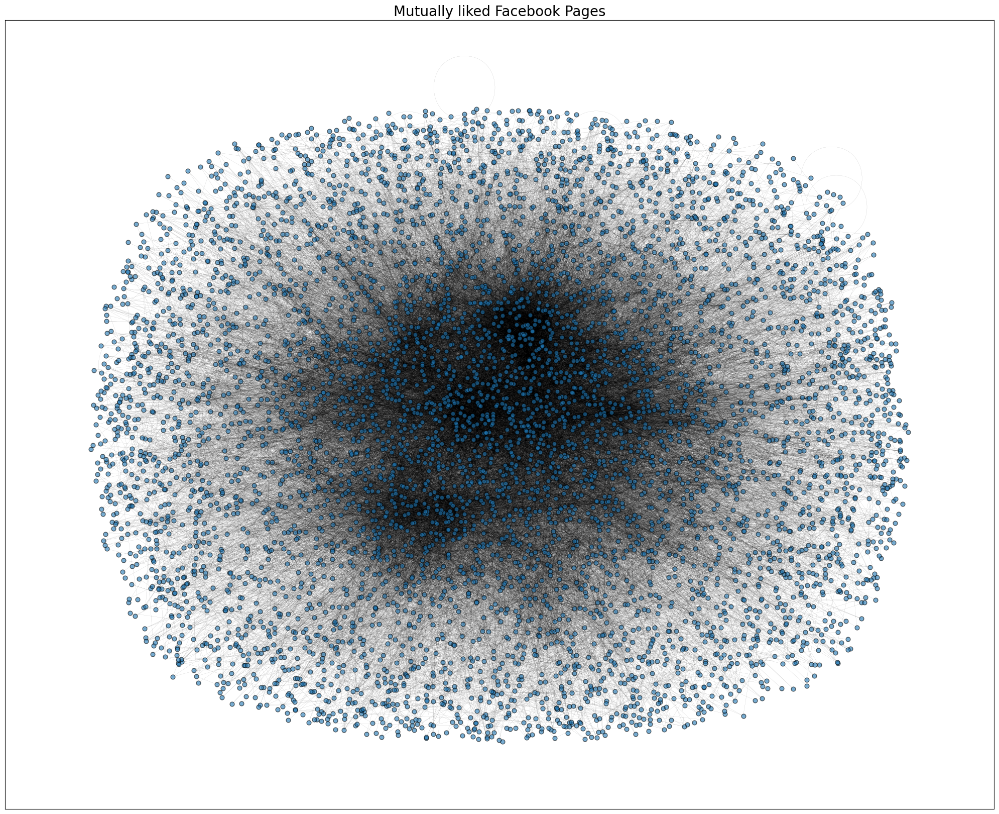

In [ ]:
size= 20
title = "Mutually liked Facebook Pages"
fig,ax = plt.subplots(figsize=(size,size-4))
pos = nx.spring_layout(G,seed=42, k=0.15, iterations=20)

# nodes
options= {"edgecolors": "black", "node_size": 40, "alpha": 0.6}
nx.draw_networkx_nodes(G, pos, node_color="tab:blue", **options)

# edges
nx.draw_networkx_edges(G, pos,width=0.1, alpha=0.5, edge_color="black")

# labels
#nx.draw_networkx_labels(G, pos, font_size=8, font_family="sans-serif"

plt.tight_layout()
plt.axis("on")
plt.title(title,fontsize=20)
plt.show()

##Network Analysis##
**Degree Distibution**

The degree distribution shows us that low number of nodes have very high degree while high number of nodes have low degree. Making the distribution highly skewed.This indicates that a small number of high influence pages have a broder base while a large number of pages have low influence. This shows power law distribution.

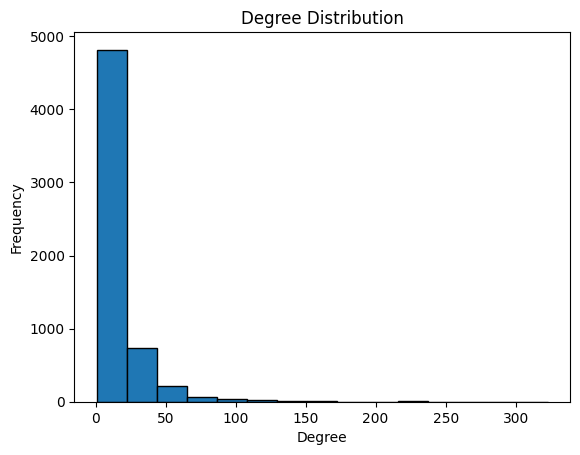

In [ ]:
plot_degree_dist(G)

Finding the Largest Component of the Real Network


In [ ]:
giant_component_graph = giant_component(G)

Number of connected components: 1
Size of the largest connected component: 5908


Centrality Measures of the Facebook Pages Network

In [ ]:
diameter_pathlen(G)

The diameter is: 14
The average shortest path length is: 4.664106961904097


In [ ]:
clustering(G)

      Node  Clustering Coefficient
5882  2636                     1.0
5895  3676                     1.0
5894  3572                     1.0
3908  5331                     1.0
781   4131                     1.0
Average Density: 0.002391445651791438
Average Clustering Coefficient: 0.38509612579327385


In [ ]:
degree(G)

      Node  Degree
2122  1864     323
4064  4874     250
4964  5800     233
2250  5416     229
644   1595     222


In [ ]:
centrality(G)

Top 5 most influential nodes based on Degree Centrality:
Node: 1864.0, Degree Centrality: 0.05468088708312172
Node: 4874.0, Degree Centrality: 0.04232266802099204
Node: 5800.0, Degree Centrality: 0.03944472659556458
Node: 5416.0, Degree Centrality: 0.038767563907228714
Node: 1595.0, Degree Centrality: 0.037582529202640935
Top 5 most influential nodes based on Eigenvector Centrality:
Node: 5416.0, Eigenvector Centrality: 0.17410127363429795
Node: 1595.0, Eigenvector Centrality: 0.16992830963567745
Node: 4602.0, Eigenvector Centrality: 0.16844123956830778
Node: 4972.0, Eigenvector Centrality: 0.16026738076504254
Node: 1414.0, Eigenvector Centrality: 0.15950464023278405
Top 5 most influential nodes based on Page Rank:
Node: 3008.0, Page Rank: 0.00484719597470406
Node: 5800.0, Page Rank: 0.004217908915371264
Node: 1864.0, Page Rank: 0.003773396203600152
Node: 4874.0, Page Rank: 0.002730191550926171
Node: 3576.0, Page Rank: 0.002209624756444758
Top 5 most influential nodes based on Closenes

/usr/local/lib/python3.11/dist-packages/networkx/drawing/nx_pylab.py:457: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


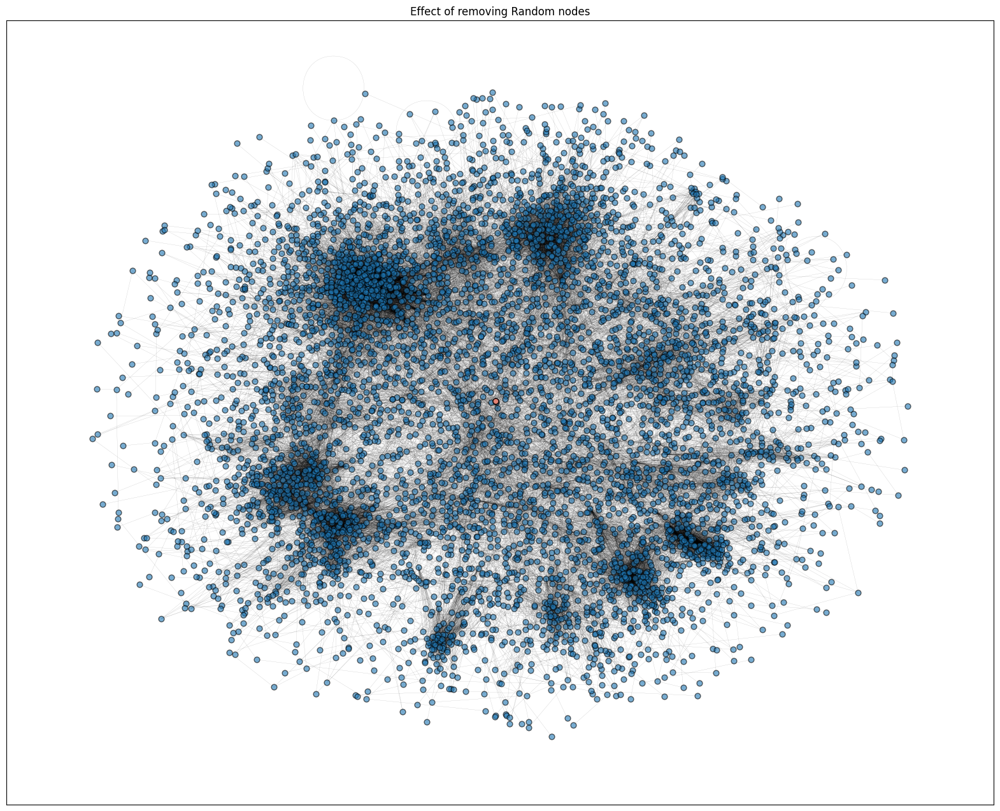

In [ ]:
# removing random nodes
def rem_nodes(G, num_rem, title):

    G_copy = G.copy()
    nodes_to_rem = num_rem
    G_copy.remove_nodes_from(nodes_to_rem)

    # sort components
    components = sorted(nx.connected_components(G_copy), key=len, reverse=True)
    # Different color for each component
    component_colors = {}
    for i, component in enumerate(components):
        component_colors[tuple(component)] = f"C{i}"

    if not components:
        return None


    # Create a dictionary to store color for each component
    color_palette = plt.get_cmap("tab20").colors

    size = 20
    fig, ax = plt.subplots(figsize=(size, size-4))


    for i, component in enumerate(components):

      subgraph = G.subgraph(component)
      pos = nx.spring_layout(subgraph, k=0.1, seed=42)
      node_colors = color_palette[i % len(color_palette)]


      # nodes
      options = {"edgecolors": "black", "node_size": 40, "alpha": 0.6}
      nx.draw_networkx_nodes(subgraph, pos,node_color=node_colors, **options)

      # edges
      nx.draw_networkx_edges(subgraph, pos, width=0.1, alpha=0.5)
    ax.set_title(title)
    plt.show()


remove = np.random.randint(1, 101, size=100).tolist()
giant = rem_nodes(G,remove,"Effect of removing Random nodes")

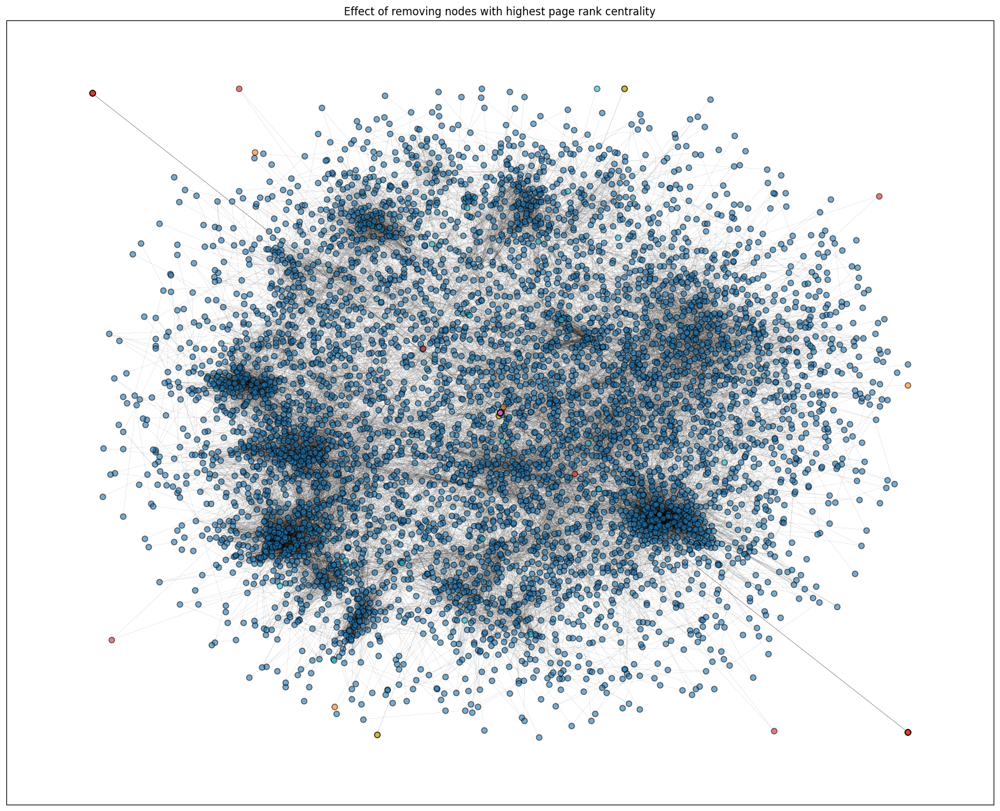

In [ ]:
def rem_nodes_HD(G):
    #removing high centrality nodes
    pagerank = nx.pagerank(G)
    top = sorted(pagerank.items(), key=lambda x: x[1], reverse=True)[:100]
    G_copy = G.copy()

    nodes_to_remove = []
    for node, x in top:
      nodes_to_remove.append(node)
    G_copy.remove_nodes_from(nodes_to_remove)

    components = list(nx.connected_components(G_copy))
    largest_component = None
    if components:
        largest_component = max(components, key=len)

    # Different color for each component
    component_colors = {}
    for i, component in enumerate(components):
        component_colors[tuple(component)] = f"C{i}"

    size = 20
    fig, ax = plt.subplots(figsize=(size, size-4))

    title = "Effect of removing nodes with highest page rank centrality"

    if not components:
        return "No connected components"
    for i, component in enumerate(components):
        subgraph = G_copy.subgraph(component)
        pos = nx.spring_layout(subgraph, k=0.1, seed=42)


        # nodes
        options = {"edgecolors": "black", "node_size": 40, "alpha": 0.6}
        nx.draw_networkx_nodes(subgraph, pos, node_color=component_colors[tuple(component)], **options)

        # edges
        nx.draw_networkx_edges(subgraph, pos, width=0.1, alpha=0.5)
    ax.set_title(title)
    plt.show()

rem_nodes_HD(G)

Centrality Measures of the Erdos Renyi random Network

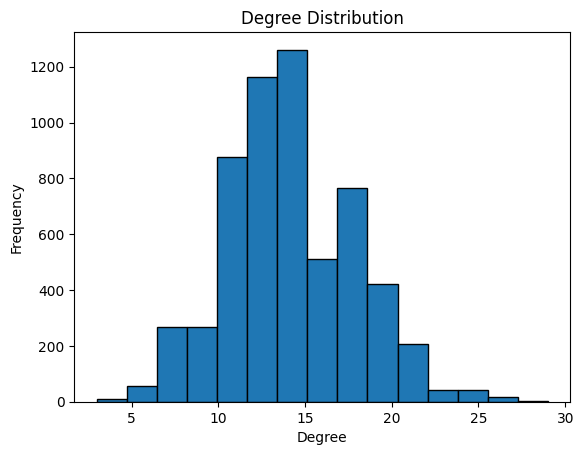

In [ ]:
plot_degree_dist(random_graph)

In [ ]:
giant_component_graph = giant_component(random_graph)

Number of connected components: 1
Size of the largest connected component: 5908


In [ ]:
diameter_pathlen(random_graph)

The diameter is: 5
The average shortest path length is: 3.5787038294650357


In [ ]:
clustering(random_graph)

      Node  Clustering Coefficient
4141  4141                0.100000
392    392                0.066667
395    395                0.066667
3523  3523                0.047619
5807  5807                0.047619
Average Density: 0.002392878375827355
Average Clustering Coefficient: 0.0022855859403949973


In [ ]:
degree(random_graph)

      Node  Degree
443    443      29
4351  4351      29
5032  5032      28
3413  3413      28
1277  1277      27


In [ ]:
centrality(random_graph)

Top 5 most influential nodes based on Degree Centrality:
Node: 443.0, Degree Centrality: 0.004909429490435077
Node: 4351.0, Degree Centrality: 0.004909429490435077
Node: 5032.0, Degree Centrality: 0.004740138818351109
Node: 3413.0, Degree Centrality: 0.004740138818351109
Node: 1277.0, Degree Centrality: 0.0045708481462671405
Top 5 most influential nodes based on Eigenvector Centrality:
Node: 444.0, Eigenvector Centrality: 0.02927176014831825
Node: 4351.0, Eigenvector Centrality: 0.028587399556285992
Node: 3413.0, Eigenvector Centrality: 0.027800341033157764
Node: 442.0, Eigenvector Centrality: 0.026747457997945503
Node: 1277.0, Eigenvector Centrality: 0.026197978783546672
Top 5 most influential nodes based on Page Rank:
Node: 443.0, Page Rank: 0.00032283596488940416
Node: 4351.0, Page Rank: 0.0003169826366665226
Node: 5032.0, Page Rank: 0.0003112618488993587
Node: 3413.0, Page Rank: 0.0003067155119574812
Node: 2847.0, Page Rank: 0.00030200094655985716
Top 5 most influential nodes based

/usr/local/lib/python3.11/dist-packages/networkx/drawing/nx_pylab.py:457: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


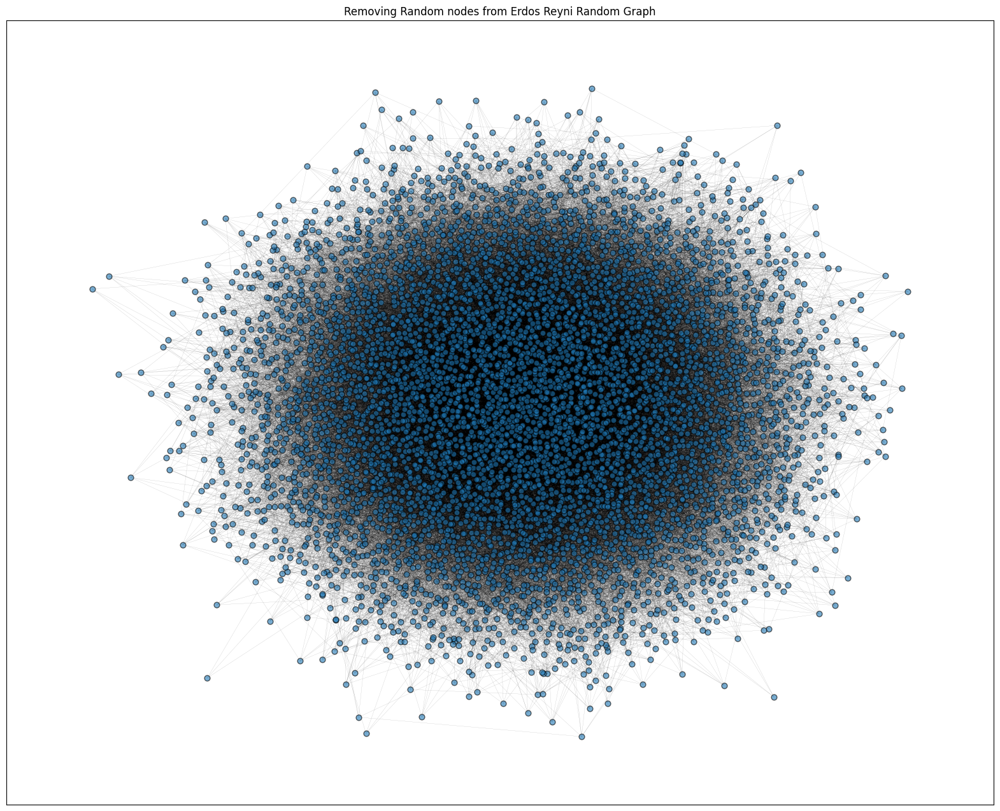

In [ ]:
rem_nodes(random_graph,remove,"Removing Random nodes from Erdos Reyni Random Graph")

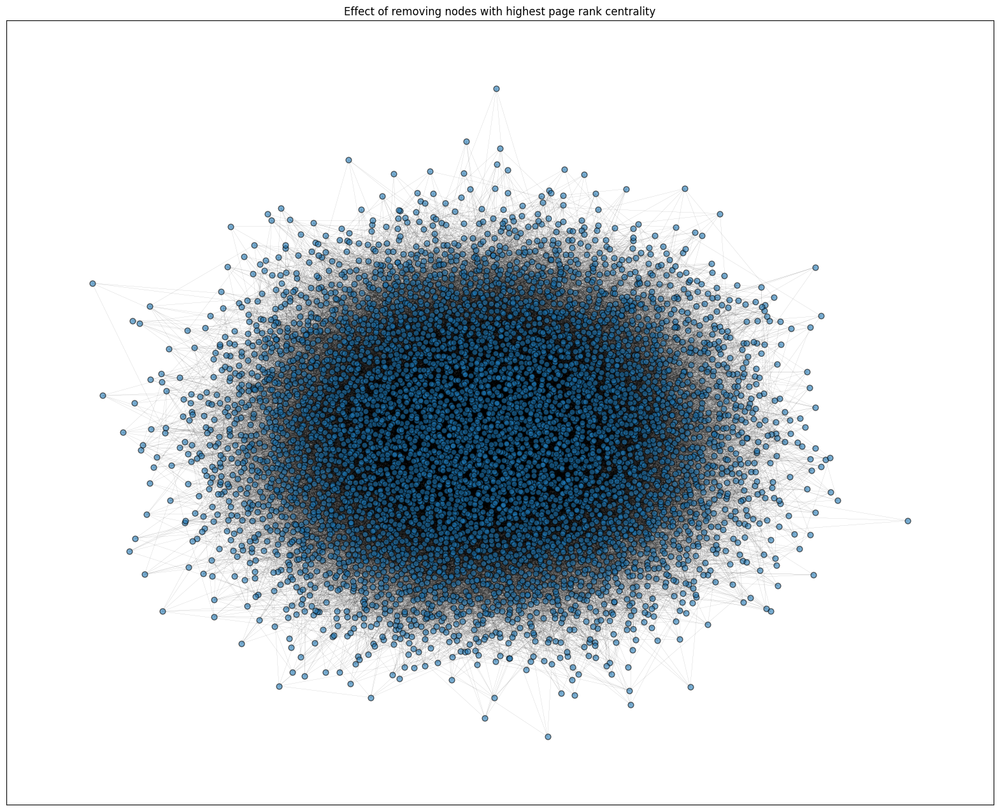

In [ ]:
rem_nodes_HD(random_graph)

Centrality Measures of the Barabasi Albert Network

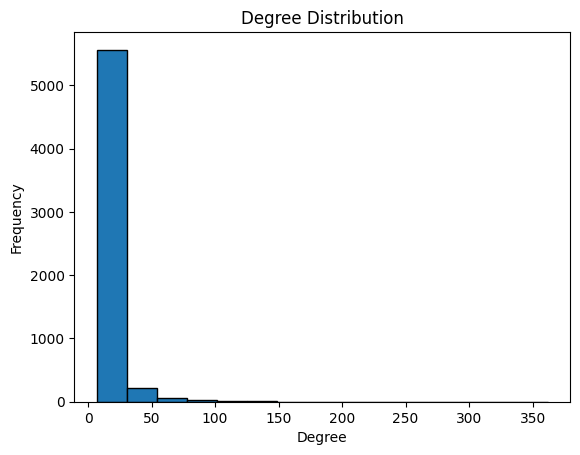

In [ ]:
plot_degree_dist(Ba_g)

In [ ]:
giant_component_graph = giant_component(Ba_g)

Number of connected components: 1
Size of the largest connected component: 5908


In [ ]:
diameter_pathlen(Ba_g)

The diameter is: 5
The average shortest path length is: 3.2252704094690907


In [ ]:
clustering(Ba_g)

      Node  Clustering Coefficient
4719  4719                0.190476
5197  5197                0.190476
2471  2471                0.166667
2847  2847                0.142857
3018  3018                0.142857
Average Density: 0.0023672612700651567
Average Clustering Coefficient: 0.011891366539938625


In [ ]:
degree(Ba_g)

    Node  Degree
0      0     362
8      8     296
12    12     287
10    10     256
4      4     231


In [ ]:
centrality(Ba_g)

Top 5 most influential nodes based on Degree Centrality:
Node: 0.0, Degree Centrality: 0.06128322329439648
Node: 8.0, Degree Centrality: 0.05011003893685458
Node: 12.0, Degree Centrality: 0.04858642288809887
Node: 10.0, Degree Centrality: 0.04333841205349585
Node: 4.0, Degree Centrality: 0.03910614525139665
Top 5 most influential nodes based on Eigenvector Centrality:
Node: 0.0, Eigenvector Centrality: 0.24291537172580885
Node: 8.0, Eigenvector Centrality: 0.20581703595313097
Node: 12.0, Eigenvector Centrality: 0.17356534373934035
Node: 10.0, Eigenvector Centrality: 0.1595275284074521
Node: 9.0, Eigenvector Centrality: 0.1520755810260805
Top 5 most influential nodes based on Page Rank:
Node: 0.0, Page Rank: 0.003761983472921764
Node: 8.0, Page Rank: 0.0030306772633077817
Node: 12.0, Page Rank: 0.002989086264698079
Node: 10.0, Page Rank: 0.0026701100721635515
Node: 4.0, Page Rank: 0.0024121610536671223
Top 5 most influential nodes based on Closeness Centrality:
Node: 0.0, Closeness Cent

/usr/local/lib/python3.11/dist-packages/networkx/drawing/nx_pylab.py:457: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


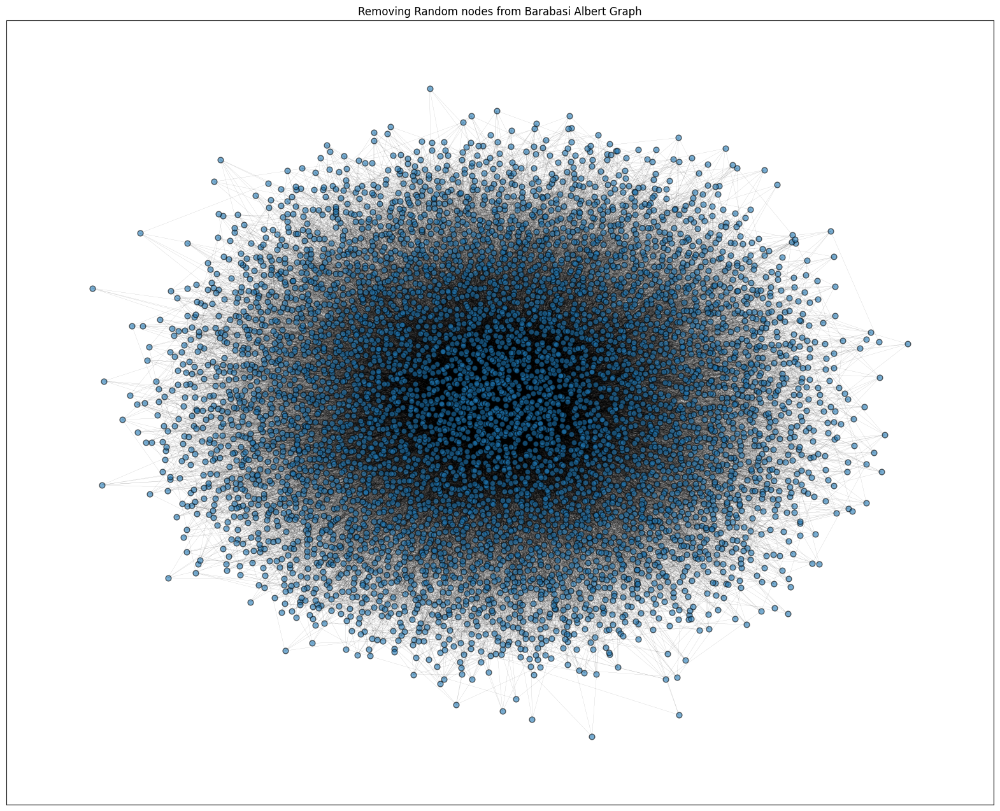

In [ ]:
rem_nodes(Ba_g,remove,"Removing Random nodes from Barabasi Albert Graph")

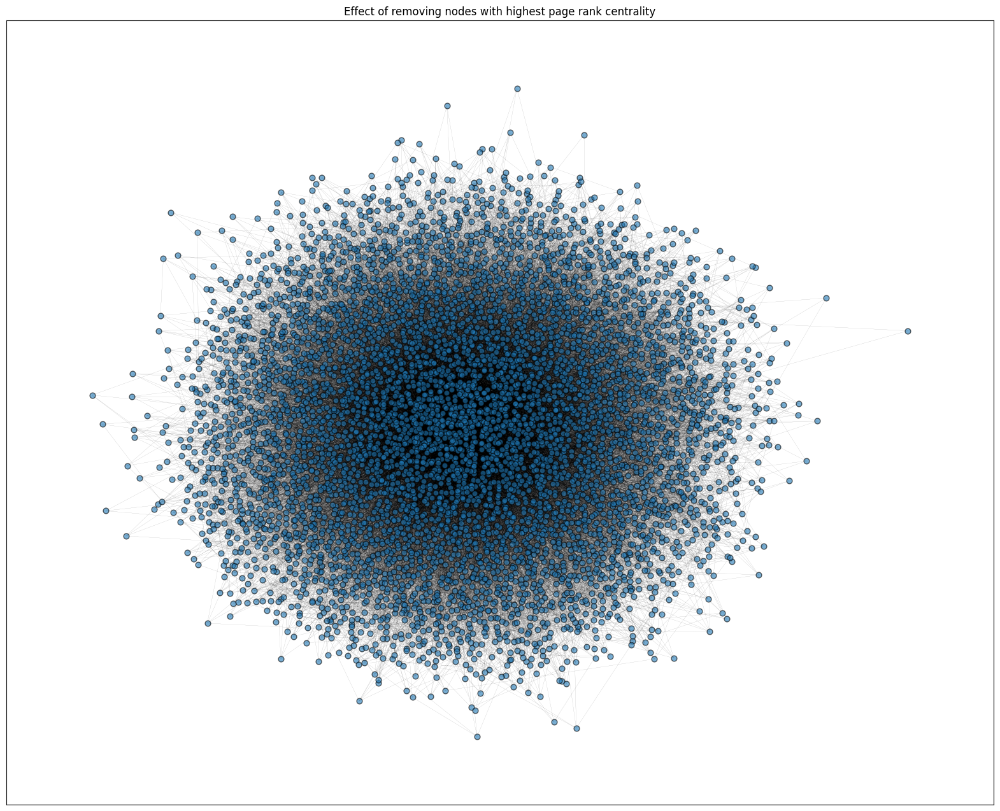

In [ ]:
rem_nodes_HD(Ba_g)

Centrality Measures of the Watts Strogatz Network

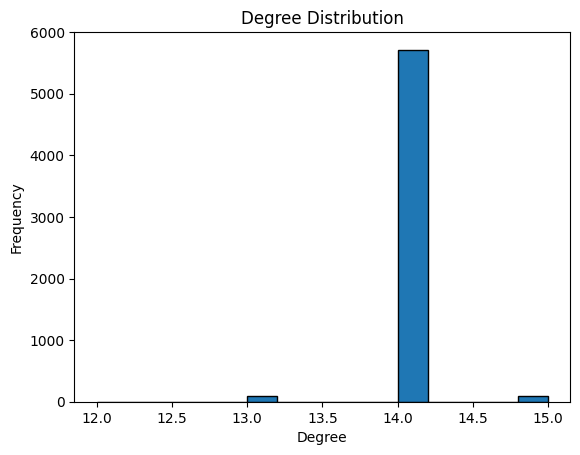

In [ ]:
plot_degree_dist(Ws_g)

In [ ]:
giant_component_graph = giant_component(Ws_g)

Number of connected components: 1
Size of the largest connected component: 5908


In [ ]:
diameter_pathlen(Ws_g)

The diameter is: 38
The average shortest path length is: 17.362494138725967


In [ ]:
clustering(Ws_g)

      Node  Clustering Coefficient
2780  2780                0.730769
4502  4502                0.730769
2425  2425                0.730769
3164  3164                0.730769
3592  3592                0.730769
Average Density: 0.0023700694091755544
Average Clustering Coefficient: 0.687419182036616


In [ ]:
degree(Ws_g)

      Node  Degree
2634  2634      15
4489  4489      15
302    302      15
1233  1233      15
913    913      15


In [ ]:
centrality(Ws_g)

Top 5 most influential nodes based on Degree Centrality:
Node: 2634.0, Degree Centrality: 0.0025393600812595226
Node: 4489.0, Degree Centrality: 0.0025393600812595226
Node: 302.0, Degree Centrality: 0.0025393600812595226
Node: 1233.0, Degree Centrality: 0.0025393600812595226
Node: 913.0, Degree Centrality: 0.0025393600812595226
Top 5 most influential nodes based on Eigenvector Centrality:
Top 5 most influential nodes based on Page Rank:
Node: 302.0, Page Rank: 0.00018111965894633463
Node: 1105.0, Page Rank: 0.000180566302350324
Node: 3803.0, Page Rank: 0.00018032914952346234
Node: 549.0, Page Rank: 0.00018032914952346234
Node: 563.0, Page Rank: 0.0001803291495234623
Top 5 most influential nodes based on Closeness Centrality:
Node: 1099.0, Closeness Centrality: 0.08248963119161
Node: 502.0, Closeness Centrality: 0.08206218221221973
Node: 1097.0, Closeness Centrality: 0.08191310859345749
Node: 508.0, Closeness Centrality: 0.08165493979900748
Node: 193.0, Closeness Centrality: 0.081277433

/usr/local/lib/python3.11/dist-packages/networkx/drawing/nx_pylab.py:457: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


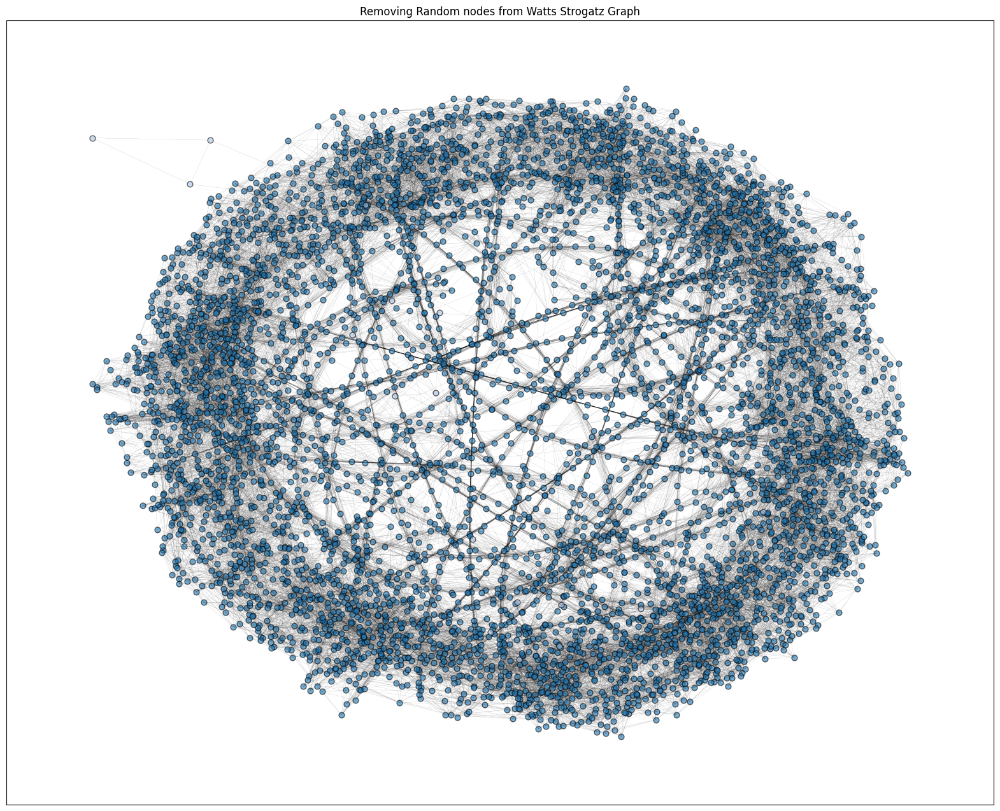

In [ ]:
rem_nodes(Ws_g,remove,"Removing Random nodes from Watts Strogatz Graph")

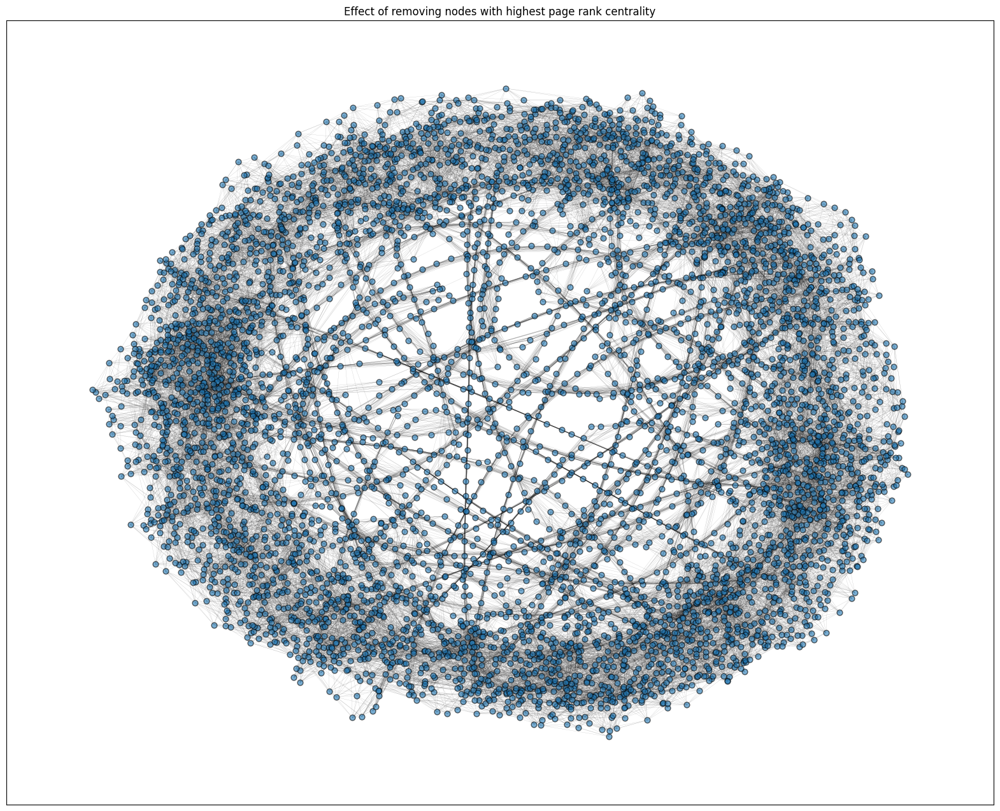

In [ ]:
rem_nodes_HD(Ws_g)


Community detection using Louvian Algorithm

Number of communities detected (Louvain): 30


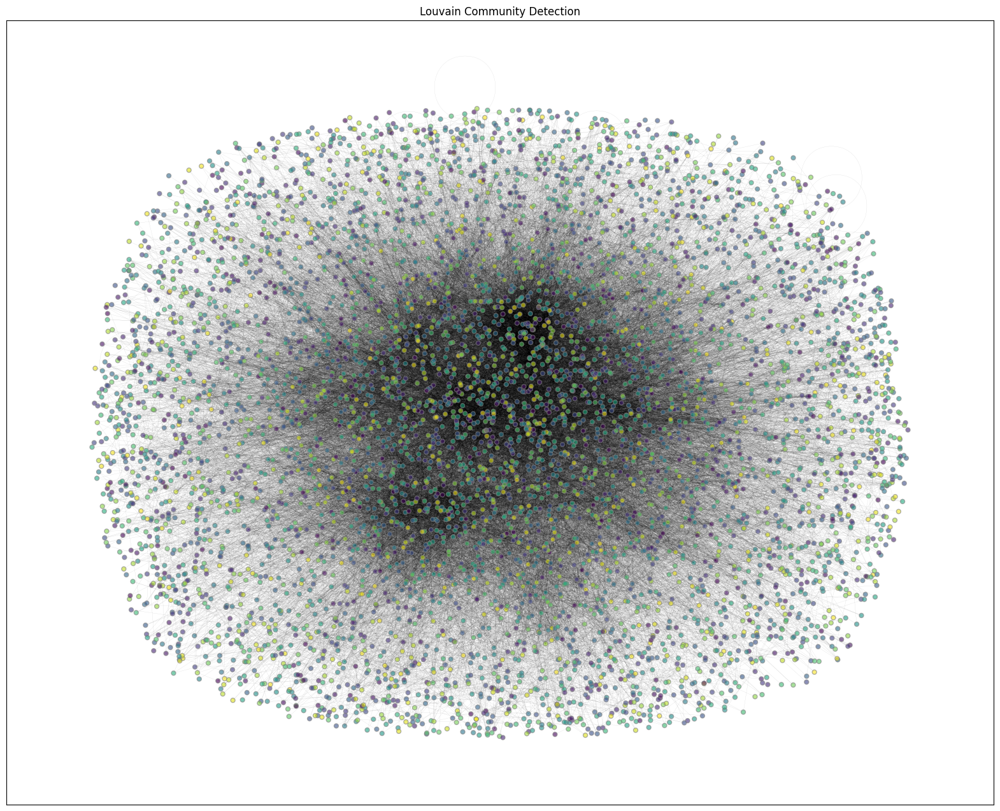

In [ ]:
partition =nx.community.louvain_communities(G, resolution=1, threshold=1e-07, max_level=None, seed=None)
num_communities = len(partition)
print(f"Number of communities detected (Louvain): {num_communities}")

# Assign colors to communities
# Assign colors based on partition
colors = []
for node in G.nodes():
    colors.append(node)
fig, ax = plt.subplots(figsize=(size, size-4))
# nx.draw(G, pos, node_color=colors, cmap=plt.cm.viridis, node_size=15, edge_color='gray', alpha=0.5)

# nodes
options = {"edgecolors": "tab:gray", "node_size": 25, "alpha": 0.6}
nx.draw_networkx_nodes(G, pos, node_color=colors,cmap=plt.cm.viridis, **options)

# edges
nx.draw_networkx_edges(G, pos, width=0.1, alpha=0.3)
plt.title("Louvain Community Detection")
plt.show()


Most Influential nodes

/usr/local/lib/python3.11/dist-packages/networkx/drawing/nx_pylab.py:457: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  node_collection = ax.scatter(


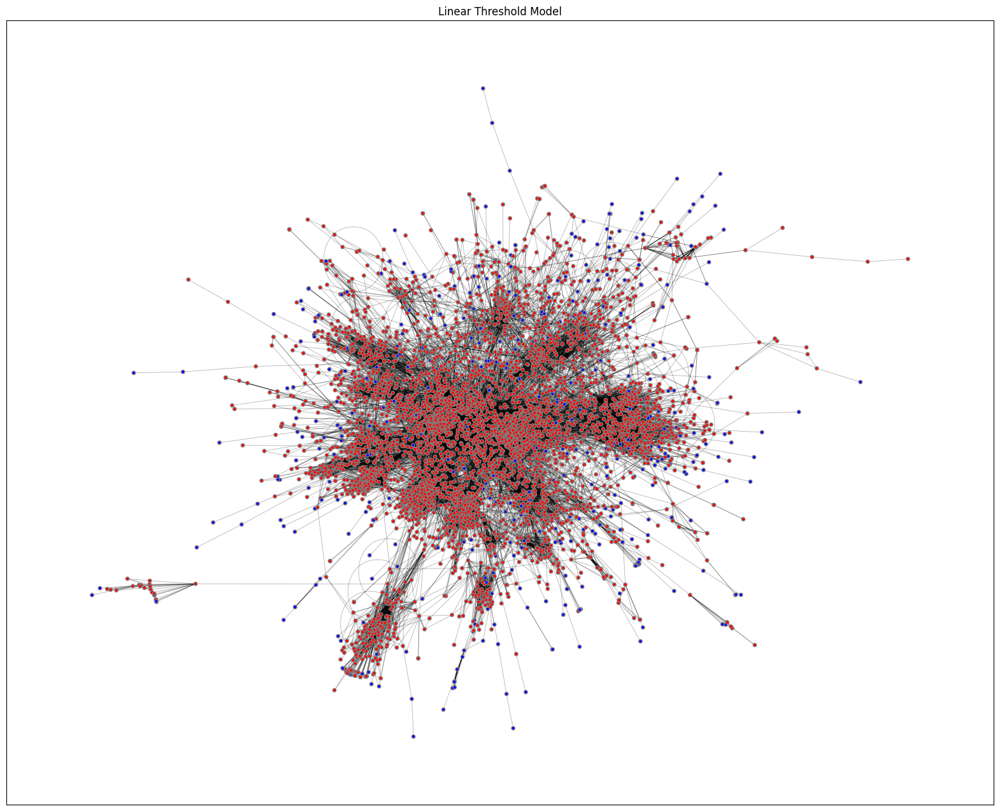

In [ ]:
def linear_threshold_model(G, snodes):
    # Assign random thresholds
    thresholds = {}
    for node in G.nodes:
        thresholds[node] = np.random.uniform(0, 1)

    # Assign random edge weights
    weights = {}
    for edge in G.edges:
        weights[edge] = np.random.uniform(0, 1)

    # Initialize active nodes
    active_nodes = set(snodes)

    # Iterative activation process
    newly_activated = True
    while newly_activated:
        newly_activated = False

        # Nodes that are not yet active
        inactive_nodes = set(G.nodes) - active_nodes

        for node in inactive_nodes:
            total_weight = 0

            for neighbor in G.neighbors(node):
                if neighbor in active_nodes:
                    total_weight += weights.get((neighbor, node), 0)
                    total_weight += weights.get((node, neighbor), 0)

            if total_weight >= thresholds[node]:
                active_nodes.add(node)
                newly_activated = True

    return active_nodes


# Select initial seed nodes  1 randomly
seed_nodes = np.random.choice(G.nodes, size=100, replace=False)

# Run the model
final_active_nodes = linear_threshold_model(G, seed_nodes)

def show_threshold(final_active_nodes):
    # Assign colors based on activation
    node_colors = []
    for node in G.nodes:
        if node in final_active_nodes:
            node_colors.append("red")
        else:
            node_colors.append("blue")

    # Draw the graph
    fig, ax = plt.subplots(figsize=(size, size-4))
    pos = nx.spring_layout(G, seed=42)
    # nodes
    options = {"edgecolors": "tab:gray", "node_size": 15}
    nx.draw_networkx_nodes(G, pos, node_color=node_colors,cmap=plt.cm.viridis, **options)

    # edges
    nx.draw_networkx_edges(G, pos, width=0.6, alpha=0.3)
    plt.title("Linear Threshold Model")
    plt.show()
show_threshold(final_active_nodes)